# 1. Imports (including new ones)

In [1]:
# 1. Imports (including new ones)
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import re
import nltk
from nltk.corpus import stopwords
from wordcloud import WordCloud
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix
import warnings
warnings.filterwarnings("ignore")
nltk.download('stopwords')


[nltk_data] Downloading package stopwords to C:\Users\ARJAV
[nltk_data]     JAIN/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

# 2. Load Data

In [2]:
# 2. Load Data
train_data = pd.read_csv("train_data.csv")
valid_data = pd.read_csv("valid_data.csv")


# 3. Basic Info

In [3]:
# 3. Basic Info
print("Train shape:", train_data.shape)
print(train_data['label'].value_counts())


Train shape: (16990, 2)
label
2     3545
18    2118
14    1822
9     1557
5      987
16     985
1      837
19     823
7      624
6      524
15     501
17     495
12     487
13     471
4      359
3      321
0      255
8      166
10      69
11      44
Name: count, dtype: int64


In [6]:
train_df = pd.read_csv("train_data.csv")

# 2. Group and count by label (assuming sentiment labels are in 'label' column)
temp = train_df.groupby('label').count()['text'].reset_index().sort_values(by='text', ascending=False)

# 3. Visualize with color gradient
temp.style.background_gradient(cmap='Purples')


,label,text
2,2,3545
18,18,2118
14,14,1822
9,9,1557
5,5,987
16,16,985
1,1,837
19,19,823
7,7,624
6,6,524


# 4. Tweet Length Analysis

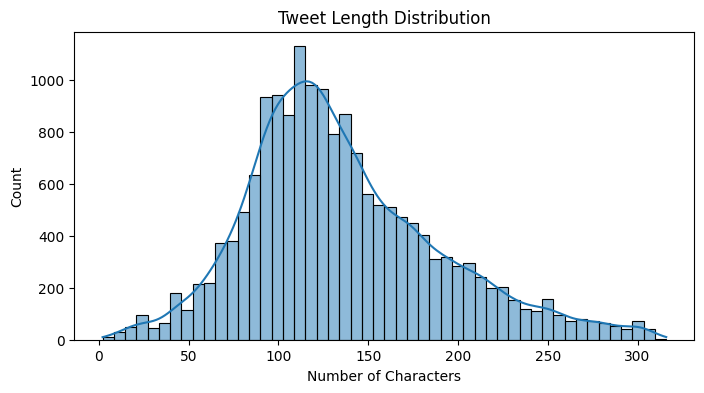

In [7]:
# 4. Tweet Length Analysis
train_data['text_length'] = train_data['text'].astype(str).apply(len)
plt.figure(figsize=(8, 4))
sns.histplot(train_data['text_length'], kde=True, bins=50)
plt.title("Tweet Length Distribution")
plt.xlabel("Number of Characters")
plt.show()

In [9]:
import plotly.graph_objects as go
import pandas as pd

# Load data and group if not already done
train_df = pd.read_csv("train_data.csv")
temp = train_df.groupby('label').count()['text'].reset_index().sort_values(by='text', ascending=False)

# Funnelarea Chart
fig = go.Figure(go.Funnelarea(
    text=temp['label'],           # Fix: use 'label' instead of 'sentiment'
    values=temp['text'],
    title={"position": "top center", "text": "Funnel-Chart of Sentiment Distribution"}
))
fig.show()


# 5. Clean Text

In [11]:
# 5. Clean Text
def clean_text(text):
    text = re.sub(r"http\S+", "", text)
    text = re.sub(r"@\w+", "", text)
    text = re.sub(r"#\w+", "", text)
    text = re.sub(r"[^A-Za-z\s]", "", text)
    text = text.lower()
    tokens = text.split()
    tokens = [word for word in tokens if word not in stopwords.words('english')]
    return " ".join(tokens)

train_data['clean_text'] = train_data['text'].astype(str).apply(clean_text)
valid_data['clean_text'] = valid_data['text'].astype(str).apply(clean_text)


# 6. Word Clouds

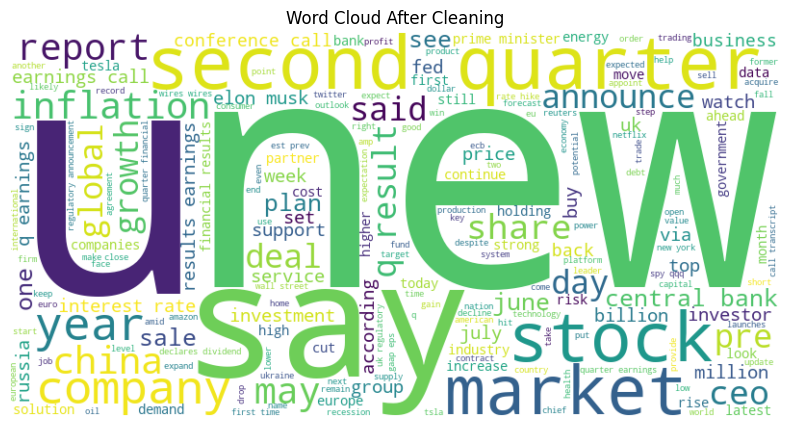

In [12]:
# 6. Word Clouds
wc = WordCloud(width=800, height=400, background_color='white').generate(" ".join(train_data['clean_text']))
plt.figure(figsize=(10, 5))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.title("Word Cloud After Cleaning")
plt.show()

# 7. Top Words by Class

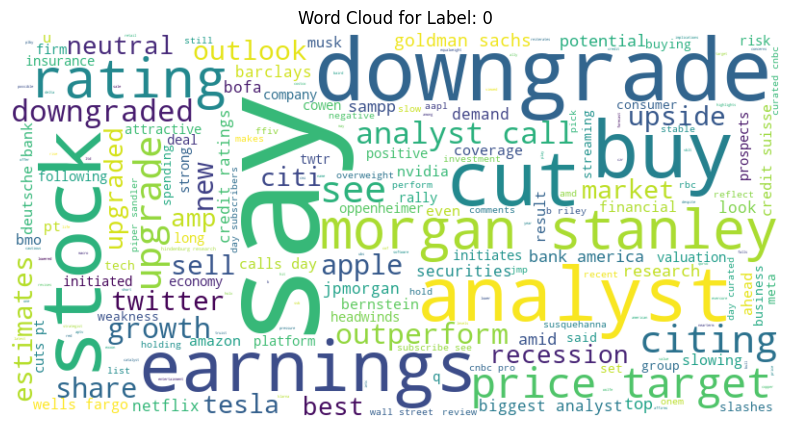

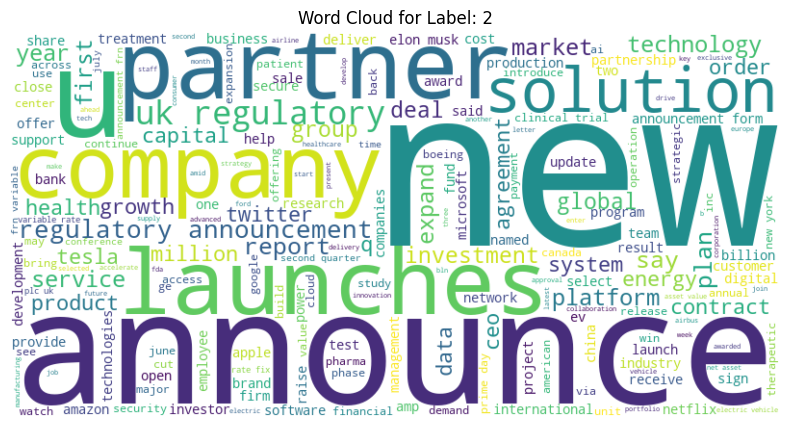

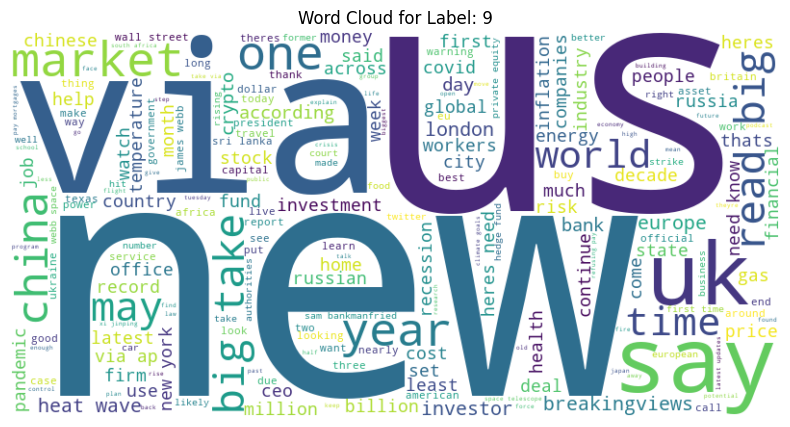

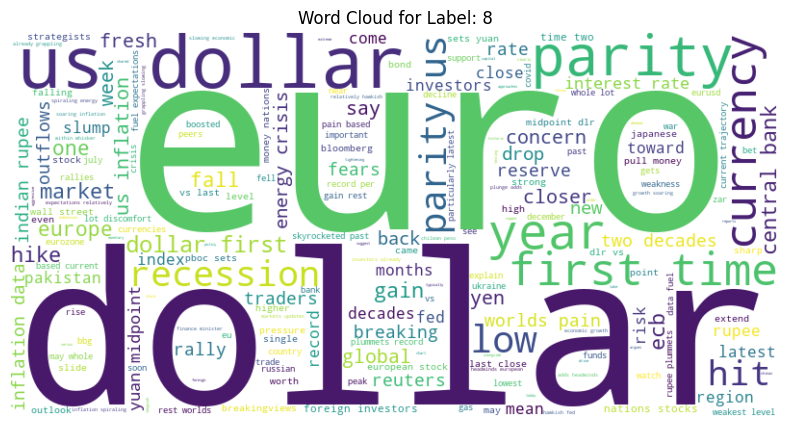

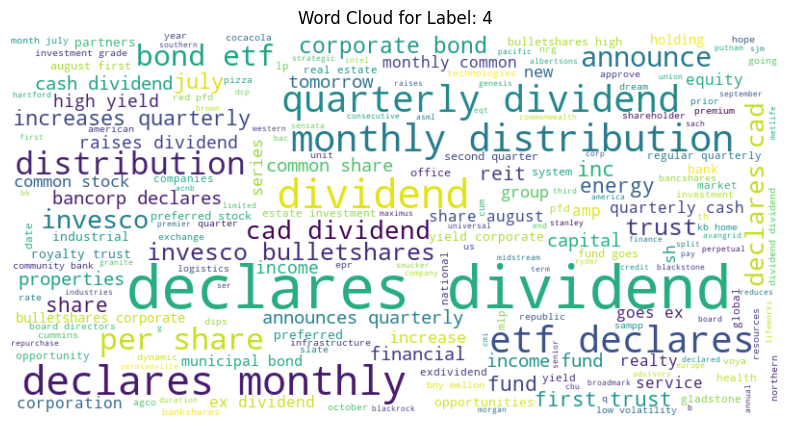

...

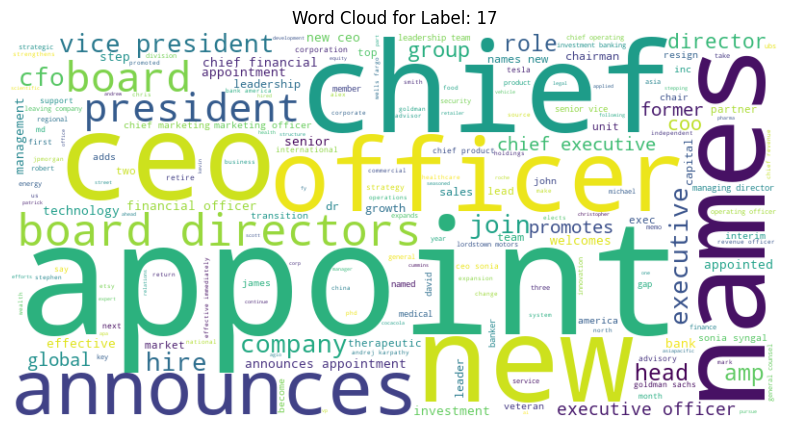

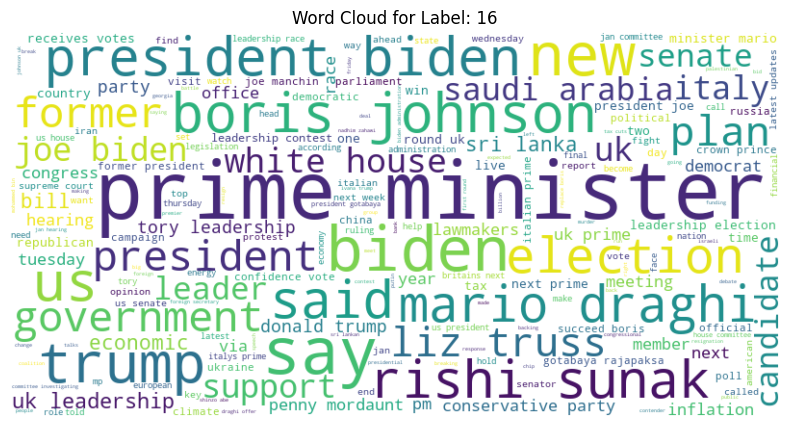

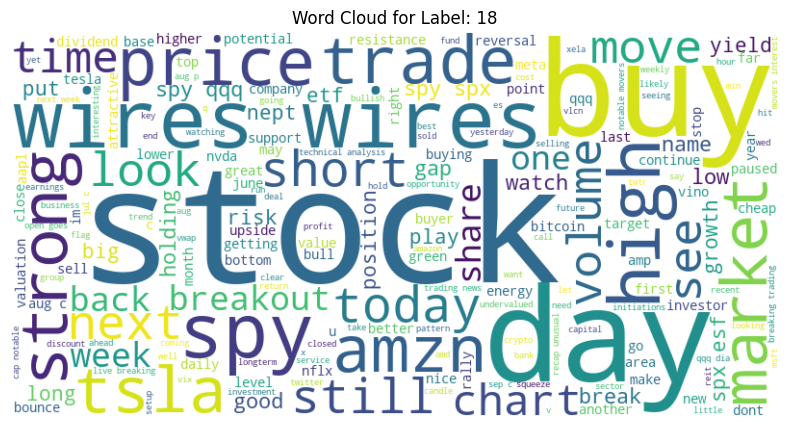

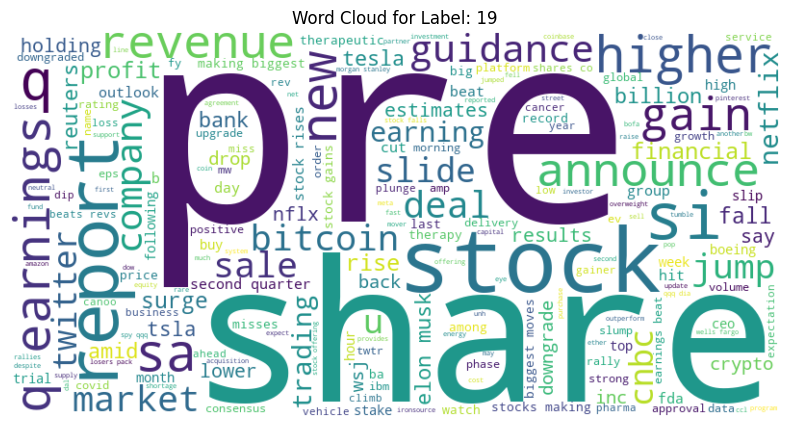

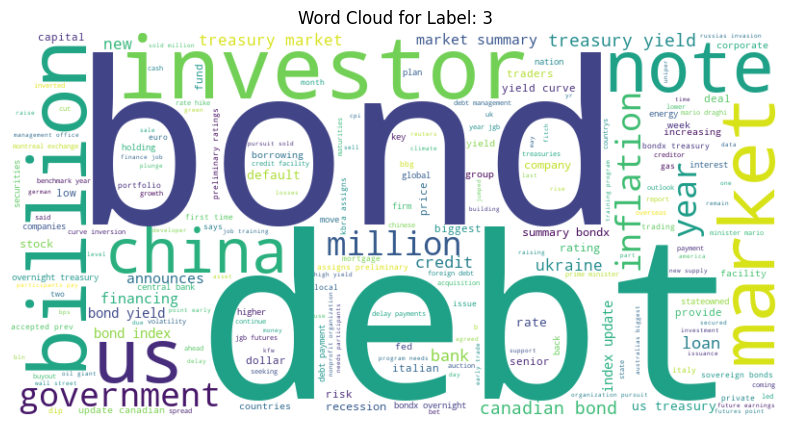

In [13]:
# 7. Top Words by Class
for label in train_data['label'].unique():
    class_words = " ".join(train_data[train_data['label'] == label]['clean_text'])
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(class_words)
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title(f"Word Cloud for Label: {label}")
    plt.show()

# 8. TF-IDF Vectorization

In [14]:
# 8. TF-IDF Vectorization
vectorizer = TfidfVectorizer(max_features=5000)
X_train = vectorizer.fit_transform(train_data['clean_text'])
X_valid = vectorizer.transform(valid_data['clean_text'])

y_train = train_data['label']
y_valid = valid_data['label']


# 9. Model Training - Logistic Regression

In [15]:
# 9. Model Training - Logistic Regression
lr_model = LogisticRegression()
lr_model.fit(X_train, y_train)
lr_preds = lr_model.predict(X_valid)

# 10. Model Training - Random Forest

In [16]:
# 10. Model Training - Random Forest
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)
rf_preds = rf_model.predict(X_valid)

# 11. Evaluation

In [17]:
# 11. Evaluation
print("\n--- Logistic Regression ---")
print(classification_report(y_valid, lr_preds))
print("Accuracy:", accuracy_score(y_valid, lr_preds))
print("\n--- Random Forest ---")
print(classification_report(y_valid, rf_preds))
print("Accuracy:", accuracy_score(y_valid, rf_preds))



--- Logistic Regression ---
              precision    recall  f1-score   support

           0       0.97      0.44      0.60        73
           1       0.83      0.76      0.79       214
           2       0.68      0.92      0.78       852
           3       0.92      0.60      0.72        77
           4       0.98      0.90      0.94        97
           5       0.93      0.91      0.92       242
           6       0.80      0.73      0.77       146
           7       0.88      0.79      0.83       160
           8       0.93      0.41      0.57        32
           9       0.66      0.63      0.64       336
          10       0.29      0.15      0.20        13
          11       1.00      0.29      0.44        14
          12       0.96      0.59      0.73       119
          13       0.86      0.48      0.62       116
          14       0.72      0.83      0.77       415
          15       0.79      0.61      0.69       125
          16       0.91      0.83      0.87       24

# 12. Confusion Matrix

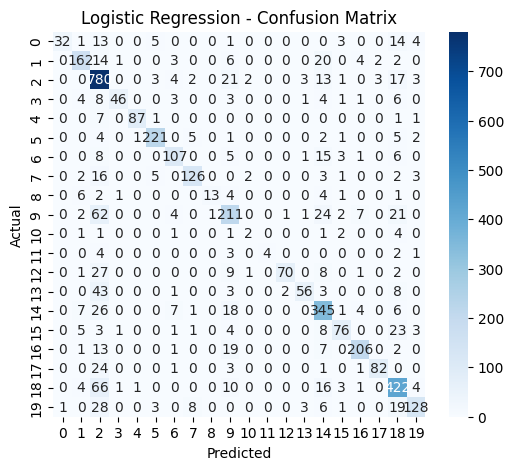

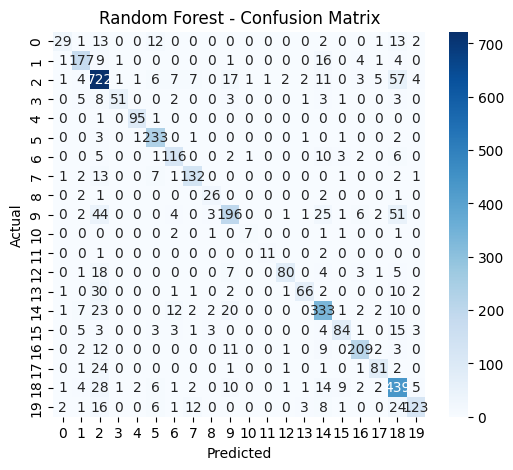

In [18]:
# 12. Confusion Matrix
def plot_cm(preds, model_name):
    cm = confusion_matrix(y_valid, preds)
    plt.figure(figsize=(6, 5))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
                xticklabels=np.unique(y_valid), yticklabels=np.unique(y_valid))
    plt.title(f"{model_name} - Confusion Matrix")
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.show()

plot_cm(lr_preds, "Logistic Regression")
plot_cm(rf_preds, "Random Forest")


# 13. Interactive Table with Plotly

In [19]:
# 13. Interactive Table with Plotly
fig = px.scatter(train_data.head(100), x='text_length', y='label', hover_data=['text'])
fig.update_layout(title='Tweet Length vs Label (sample)')
fig.show()

# 14. Export Cleaned Data

In [20]:
# 14. Export Cleaned Data
train_data[['text', 'clean_text', 'label']].to_csv("cleaned_train_data.csv", index=False)
valid_data[['text', 'clean_text', 'label']].to_csv("cleaned_valid_data.csv", index=False)
print("Cleaned files saved successfully.")


Cleaned files saved successfully.
